# DSC478 Project - Analysis (Mourad)
## Credit Card Customers Churn

In [1]:
import pandas as pd
import numpy as np
import klib
import pandas_profiling as pp
import sweetviz
import sklearn

import matplotlib.pyplot as plt
import seaborn as sns
import graphviz

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.compose import make_column_transformer
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import *
from sklearn.metrics import *

from sklearn import set_config 
from sklearn.utils import estimator_html_repr 
from IPython.core.display import display, HTML 

set_config(display='diagram')
from platform import python_version

%precision 2
pd.set_option('max_columns',200)
pd.set_option('display.precision',2)
pd.set_option('display.float_format','{:,.2f}'.format)

print('python',python_version())
print(np.__name__, np.__version__)
print(pd.__name__, pd.__version__)
print(klib.__name__, klib.__version__)
#print(pp.__name__, pp.__version__)
print(sklearn.__name__, sklearn.__version__)
print(sweetviz.__name__, sweetviz.__version__)

python 3.9.2
numpy 1.20.1
pandas 1.1.4
klib 0.1.5
sklearn 0.24.1
sweetviz 2.0.9


In [2]:
%%html
<style>
.jp-RenderedMarkdown {
    font-size:130%;
}
.CodeMirror, .CodeMirror pre, .CodeMirror-dialog, .CodeMirror-dialog .CodeMirror-search-field, .terminal-app .terminal {
    font-size: 80%;
}
</style>

# Helper Functions

In [3]:
def plot_silhouettes(data, clusters, metric='euclidean'):
    
    from matplotlib import cm
    from sklearn.metrics import silhouette_samples

    cluster_labels = np.unique(clusters)
    n_clusters = cluster_labels.shape[0]
    silhouette_vals = metrics.silhouette_samples(data, clusters, metric='euclidean')
    c_ax_lower, c_ax_upper = 0, 0
    cticks = []
    for i, k in enumerate(cluster_labels):
        c_silhouette_vals = silhouette_vals[clusters == k]
        c_silhouette_vals.sort()
        c_ax_upper += len(c_silhouette_vals)
        color = cm.jet(float(i) / n_clusters)
        plt.barh(range(c_ax_lower, c_ax_upper), c_silhouette_vals, height=1.0, 
                      edgecolor='none', color=color)

        cticks.append((c_ax_lower + c_ax_upper) / 2)
        c_ax_lower += len(c_silhouette_vals)
    
    silhouette_avg = np.mean(silhouette_vals)
    plt.axvline(silhouette_avg, color="red", linestyle="--") 

    plt.yticks(cticks, cluster_labels)
    plt.ylabel('Cluster')
    plt.xlabel('Silhouette coefficient')

    plt.tight_layout()
    plt.show()
    
    return

def plot_dendrogram(model, **kwargs):
    from scipy.cluster.hierarchy import dendrogram
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                      counts]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)


|Variable|Type|Description|
|-|-|-|
|Clientnum|	Num|	Client number. Unique identifier for the customer holding the account|
|Attrition_Flag|	Char|	Internal event (customer activity) variable - if the account is closed then 1 else 0|
|Customer_Age|	Num|	Demographic variable - Customer's Age in Years|
|Gender|	Char|	Demographic variable - M=Male, F=Female|
|Dependent_count|	Num|	Demographic variable - Number of dependents|
|Education_Level|	Char|	Demographic variable - Educational Qualification of the account holder (example: high school, college graduate, etc.)|
|Marital_Status|	Char|	Demographic variable - Married, Single, Unknown|
|Income_Category|	Char|	Demographic variable - Annual Income Category of the account holder (< $40K, $40K - 60K, $60K - $80K, $80K-$120K, > $120K, Unknown)|
|Card_Category|	Char|	Product Variable - Type of Card (Blue, Silver, Gold, Platinum)|
|Months_on_book|	Num|	Months on book (Time of Relationship)|
|Total_Relationship_Count|	Num|	Total no. of products held by the customer|
|Months_Inactive_12_mon|	Num|	No. of months inactive in the last 12 months|
|Contacts_Count_12_mon|	Num|	No. of Contacts in the last 12 months|
|Credit_Limit|	Num|	Credit Limit on the Credit Card|
|Total_Revolving_Bal|	Num|	Total Revolving Balance on the Credit Card|
|Avg_Open_To_Buy|	Num|	Open to Buy Credit Line (Average of last 12 months)|
|Total_Amt_Chng_Q4_Q1|	Num|	Change in Transaction Amount (Q4 over Q1)| 
|Total_Trans_Amt|	Num|	Total Transaction Amount (Last 12 months)|
|Total_Trans_Ct|	Num|	Total Transaction Count (Last 12 months)|
|Total_Ct_Chng_Q4_Q1|	Num|	Change in Transaction Count (Q4 over Q1)|
|Avg_Utilization_Ratio|	Num|	Average Card Utilization Ratio|


## Read **Train dataset** for analysis

The train dataset will be used for analysis.

X and y shapes:
(8101, 19) (8101,) 

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8101 entries, 3066 to 1919
Data columns (total 20 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   customer_age              8101 non-null   int64   
 1   dependent_count           8101 non-null   int64   
 2   months_on_book            8101 non-null   int64   
 3   total_relationship_count  8101 non-null   int64   
 4   months_inactive_12_mon    8101 non-null   int64   
 5   contacts_count_12_mon     8101 non-null   int64   
 6   credit_limit              8101 non-null   float64 
 7   total_revolving_bal       8101 non-null   int64   
 8   avg_open_to_buy           8101 non-null   float64 
 9   total_amt_chng_q4_q1      8101 non-null   float64 
 10  total_trans_amt           8101 non-null   int64   
 11  total_trans_ct            8101 non-null   int64   
 12  total_ct_chng_q4_q1       8101 non-null   float64 
 13  avg_util

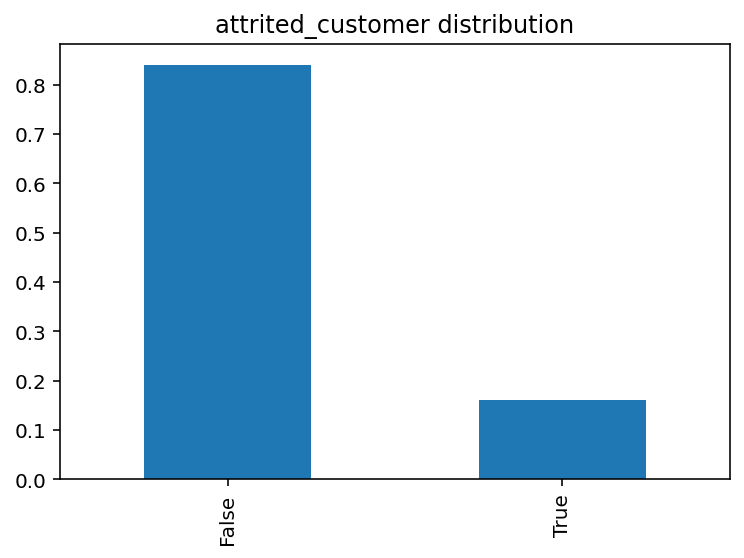

In [4]:
# Read [Train] data from CSV
df_train = pd.read_csv('./data/bank_churners_train.csv', index_col=0)

df_train.card_category = pd.Categorical(
    df_train.card_category,
    ['Blue' , 'Silver' ,'Gold' , 'Platinum'],
    ordered=True)
df_train.income_category = pd.Categorical(
    df_train.income_category,
    ['Unknown' , 'Less than $40K', '$40K - $60K', '$60K - $80K' ,'$80K - $120K' , '$120K +'],
    ordered=True)
df_train.education_level = pd.Categorical(
    df_train.education_level,
    ['Unknown' , 'Uneducated', 'High School', 'College' ,'Graduate' , 'Post-Graduate', 'Doctorate'],
    ordered=True)

df_train.gender = pd.Categorical(df_train.gender)
df_train.marital_status = pd.Categorical(df_train.marital_status)

X = df_train.iloc[:,:-1]
y = df_train.attrited_customer
print('X and y shapes:')
print(X.shape,y.shape,'\n')
print(df_train.info())
y.value_counts(normalize=True, dropna=False).plot.bar(title='attrited_customer distribution');

In [5]:
y.value_counts(normalize=True, dropna=False)

False   0.84
True    0.16
Name: attrited_customer, dtype: float64

I can see imbalanced target values at 16%

This means that accuracy scores for classification will be misleading, we will need to consider F1, Recall, and Precision scores.

Since, the target variable explains attrited customers, then we can be more tolerant with Type 1 error vs Type 2, where we might mis-classify customers to be attrited and pro-actively approached them to retain them instead of ignoring them and losing them.

Accordingly, while seeking the highest F1 score to achieve a reasonable balance, we should be favoring better recalls.

In [6]:
X.describe().T

,count,mean,std,min,25%,50%,75%,max
customer_age,"8,101.00",46.30,7.98,26.00,41.00,46.00,52.00,73.00
dependent_count,"8,101.00",2.35,1.30,0.00,1.00,2.00,3.00,5.00
months_on_book,"8,101.00",35.93,7.95,13.00,31.00,36.00,40.00,56.00
total_relationship_count,"8,101.00",3.81,1.56,1.00,3.00,4.00,5.00,6.00
months_inactive_12_mon,"8,101.00",2.35,1.01,0.00,2.00,2.00,3.00,6.00
contacts_count_12_mon,"8,101.00",2.45,1.11,0.00,2.00,2.00,3.00,6.00
credit_limit,"8,101.00","8,634.91","9,056.86","1,438.30","2,568.00","4,589.00","11,127.00","34,516.00"
total_revolving_bal,"8,101.00","1,162.16",814.18,0.00,382.00,"1,276.00","1,782.00","2,517.00"
avg_open_to_buy,"8,101.00","7,472.75","9,055.96",3.00,"1,341.00","3,515.00","9,921.00","34,516.00"
total_amt_chng_q4_q1,"8,101.00",0.76,0.22,0.00,0.63,0.74,0.86,3.40


# Define Features Names (For Convenience)

In [7]:
features_numeric     = list(df_train.columns[:14])
features_nominal     = ['gender','marital_status']
features_nominal_ohe = ['is_Female', 'is_Male', 'is_Divorced', 'is_Married', 'is_Single','is_Unknown_Marital'] # OneHotEncoded
features_ordinal     = ['education_level','income_category','card_category']
features_names       = df_train.columns[:19].values
features_names_enc   =  features_numeric + features_ordinal + features_nominal_ohe

# Scale and Transform

In [8]:
numeric_transformer = StandardScaler()
ordinal_transformer = OrdinalEncoder()
nominal_transformer = OneHotEncoder()

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, features_numeric),
        ('ord', ordinal_transformer, features_ordinal),
        ('nom', nominal_transformer, features_nominal),
    ],
    remainder='passthrough',
    n_jobs=-1
)

X_ = preprocessor.fit_transform(X)
X_enc = pd.DataFrame(X_, columns=features_names_enc, index=X.index)

In [9]:
X_enc.describe().T

,count,mean,std,min,25%,50%,75%,max
customer_age,"8,101.00",0.00,1.00,-2.55,-0.66,-0.04,0.71,3.35
dependent_count,"8,101.00",0.00,1.00,-1.82,-1.04,-0.27,0.50,2.04
months_on_book,"8,101.00",-0.00,1.00,-2.89,-0.62,0.01,0.51,2.53
total_relationship_count,"8,101.00",0.00,1.00,-1.80,-0.52,0.12,0.76,1.40
months_inactive_12_mon,"8,101.00",0.00,1.00,-2.32,-0.35,-0.35,0.64,3.61
contacts_count_12_mon,"8,101.00",0.00,1.00,-2.21,-0.41,-0.41,0.50,3.21
credit_limit,"8,101.00",0.00,1.00,-0.79,-0.67,-0.45,0.28,2.86
total_revolving_bal,"8,101.00",0.00,1.00,-1.43,-0.96,0.14,0.76,1.66
avg_open_to_buy,"8,101.00",0.00,1.00,-0.82,-0.68,-0.44,0.27,2.99
total_amt_chng_q4_q1,"8,101.00",-0.00,1.00,-3.43,-0.59,-0.11,0.45,11.89


# Correlations

Let's check correlations and only showing the highly correlated pairs having greater than abs(.6)

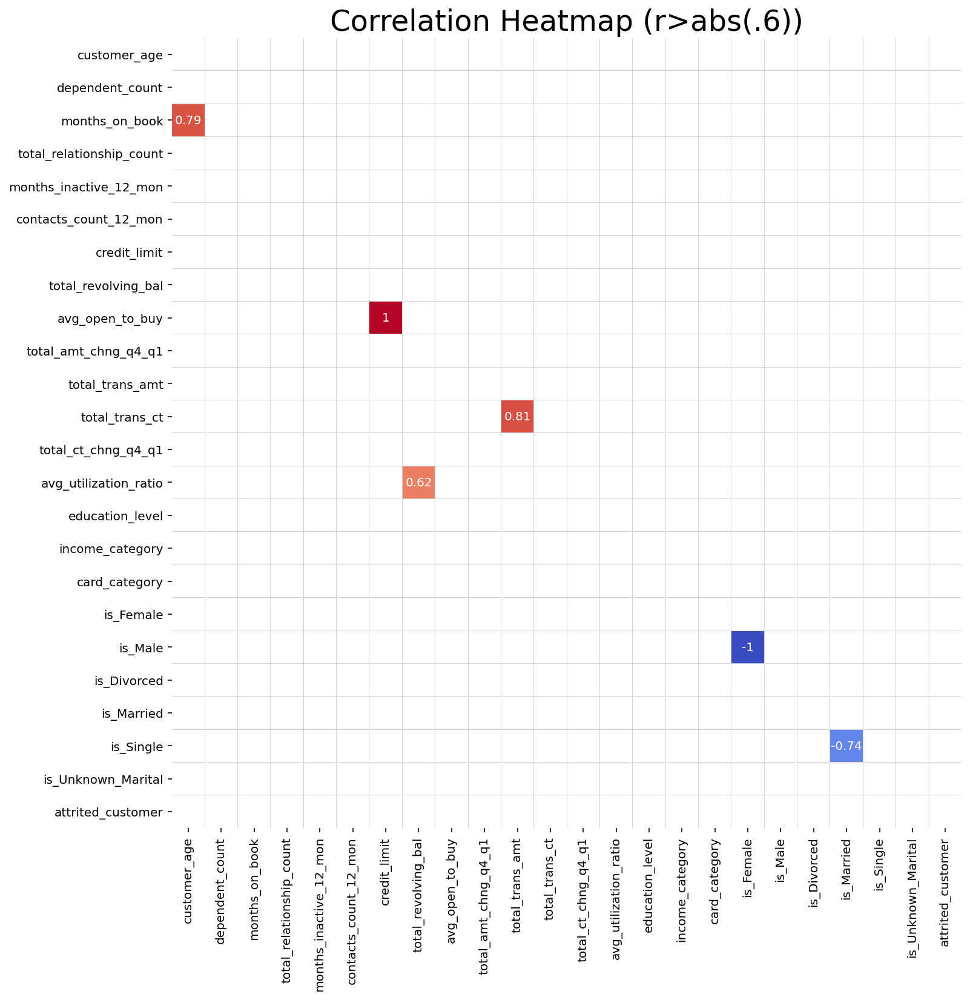

In [10]:
corr = X_enc.join(y).corr() # Join with y to be included in correlations

fig, ax = plt.subplots(figsize=(12, 12))
mask = np.triu(np.ones_like(corr, dtype=bool))
hm = sns.heatmap(corr, annot=True, center=0, linecolor='lightgray', linewidths=.01, ax=ax,
                 cmap="coolwarm", fmt='.2g', square=True, cbar=False,
                 mask=((abs(corr)<=.6) | mask))
plt.title('Correlation Heatmap (r>abs(.6))', fontsize=24);

# Pairplot

Let's check the pairplot and see if we can see any linear relations, or notice unique distributions (double click the pairplot to read details)

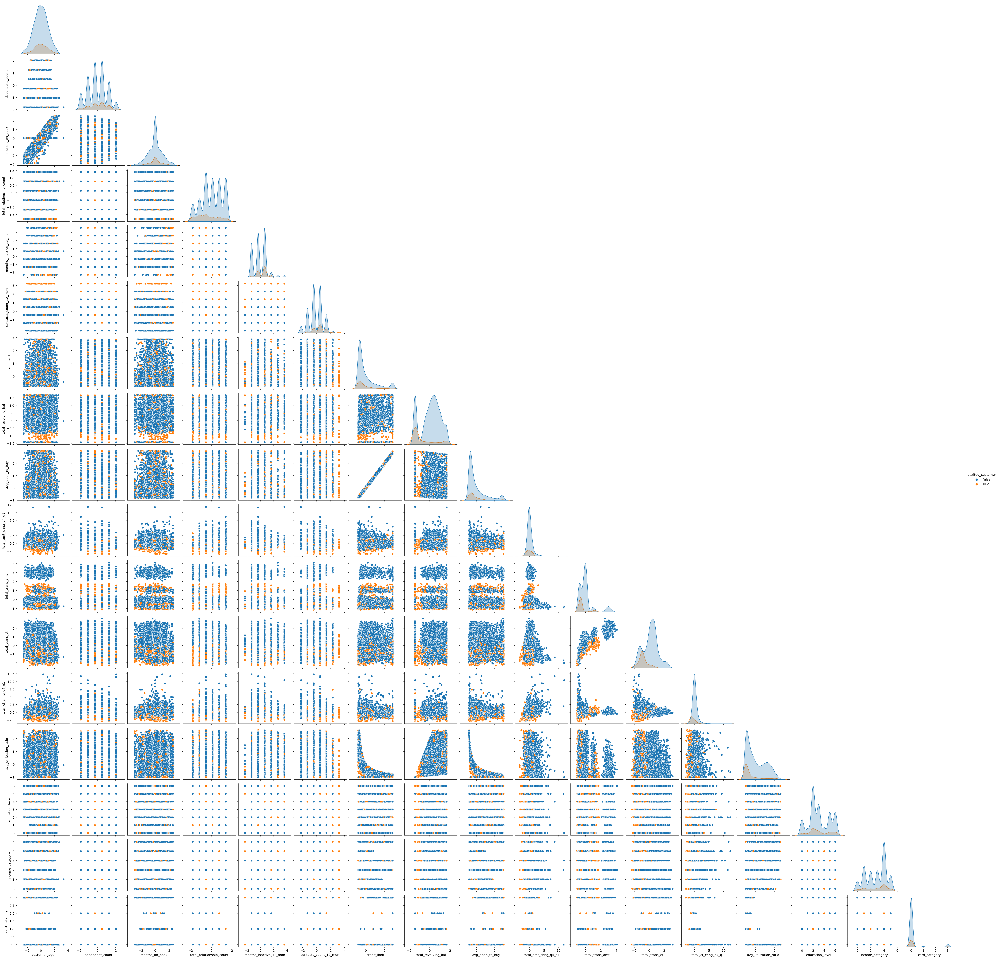

In [11]:
sns.pairplot(X_enc.join(y), vars=features_numeric+features_ordinal, hue='attrited_customer', corner=True);

# Interesting Relations

By inspecting correlations among the features, I noticed 4 interesting relations. I'll try to  investigate further.

['months_on_book','customer_age']   
['avg_open_to_buy','credit_limit']  
['avg_utilization_ratio','total_revolving_bal']  
['total_trans_ct','total_trans_amt']  

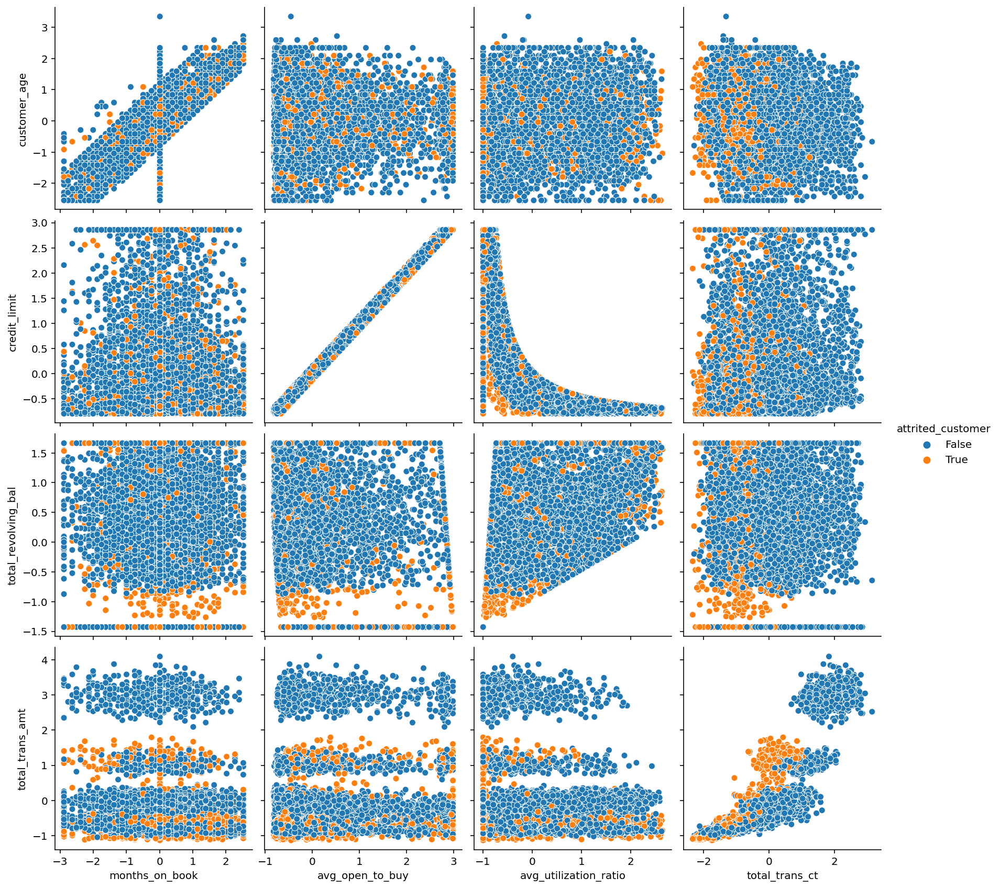

In [12]:
sns.pairplot(
    x_vars=['months_on_book','avg_open_to_buy','avg_utilization_ratio','total_trans_ct'],
    y_vars=['customer_age','credit_limit','total_revolving_bal','total_trans_amt'],
    hue='attrited_customer',
    height=3,
    data=X_enc.join(y),
    );

## Focus on total_trans_ct and total_trans_amt

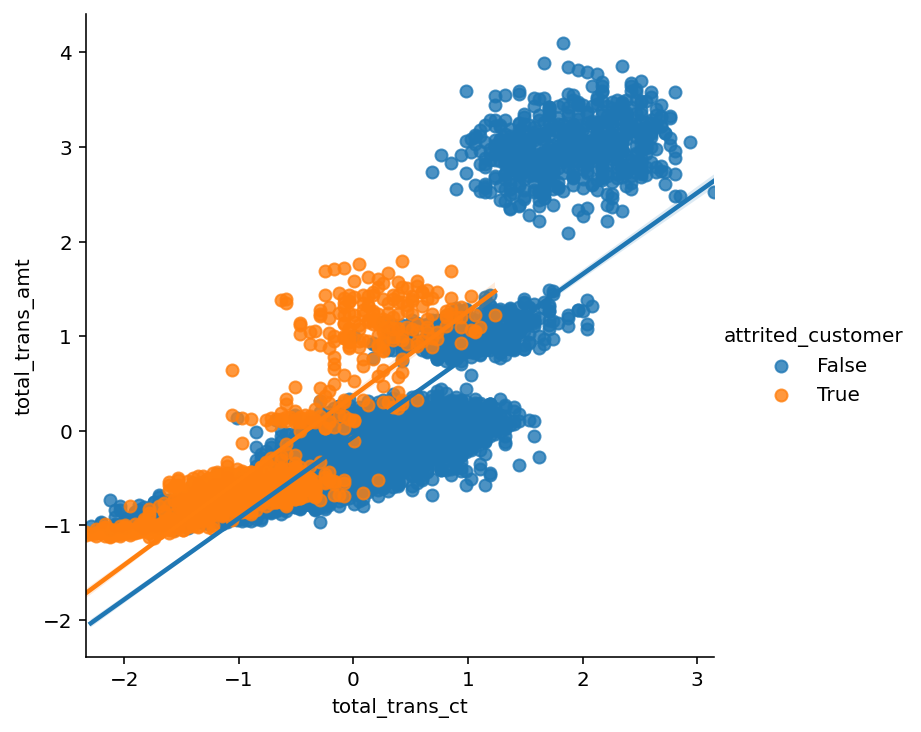

In [13]:
sns.lmplot(x="total_trans_ct", y="total_trans_amt", hue="attrited_customer",
           data=X_enc.join(y));

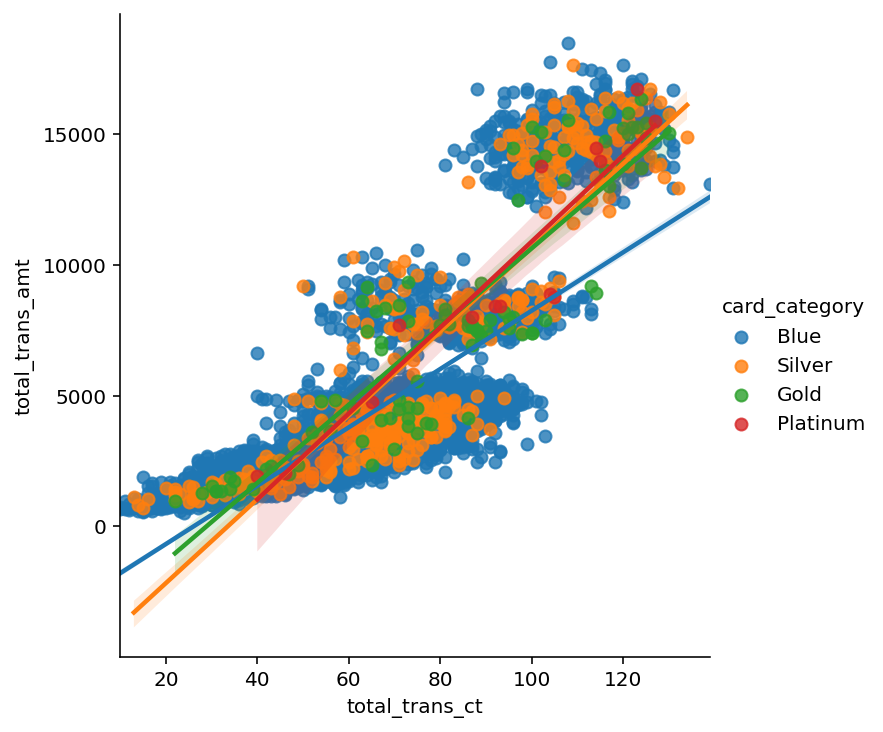

In [14]:
sns.lmplot(x="total_trans_ct", y="total_trans_amt", hue="card_category",
           #markers=['x','o','.',':'],
           data=df_train);

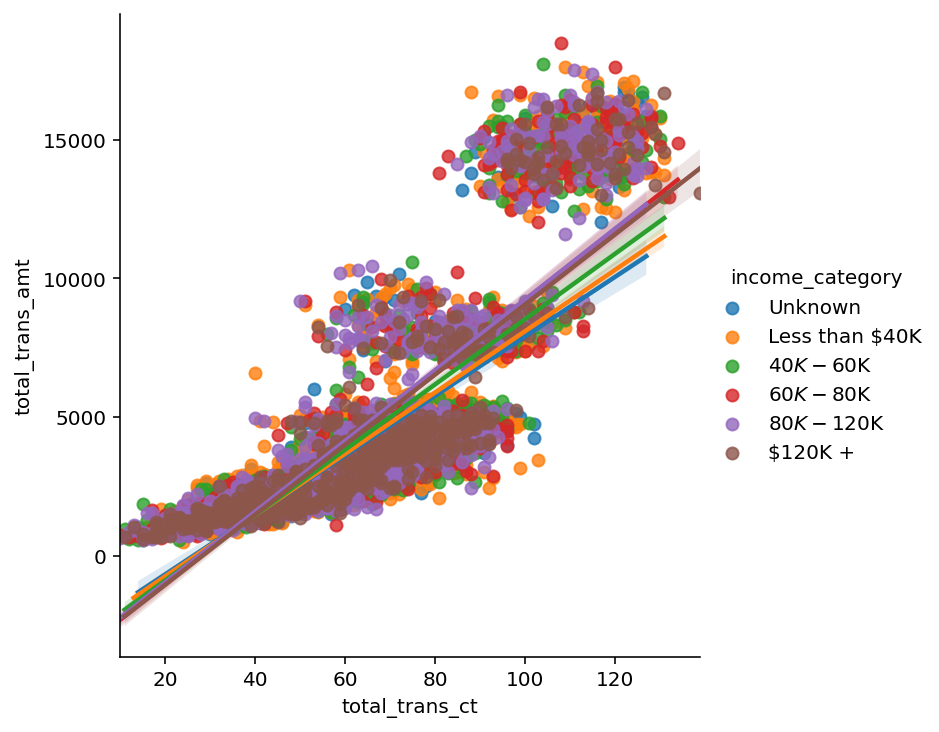

In [15]:
sns.lmplot(x="total_trans_ct", y="total_trans_amt", hue="income_category",
           #markers=['x','o','.',':'],
           data=df_train);

# Features Analysis

In [16]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier

In [17]:
clf = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('classifier', DecisionTreeClassifier())
    ])

clf.fit(X, y)

print("model score: %.3f" % clf.score(X, y))
print(classification_report(y,clf.predict(X)))

model score: 1.000
              precision    recall  f1-score   support

       False       1.00      1.00      1.00      6799
        True       1.00      1.00      1.00      1302

    accuracy                           1.00      8101
   macro avg       1.00      1.00      1.00      8101
weighted avg       1.00      1.00      1.00      8101



## Visualizing the top tree levels
We can identify that **total_trans_ct, total_revolving_bal, total_trans_amt** are the top influencing features.

If the tree is not visible in the notebook. Re-rerun the notebook, or check the html notebook export.

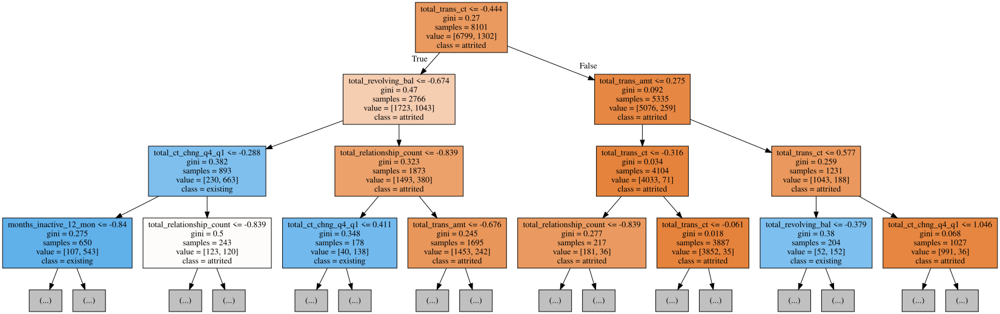

In [18]:
from sklearn.tree import export_graphviz, plot_tree

s = export_graphviz(clf.named_steps.classifier,            
                feature_names = features_names_enc, 
                class_names= ['attrited','existing'],
                filled = True,
                max_depth = 3
               )
graphviz.Source(s)

## Features by Importance

In [19]:
pd.DataFrame(clf.named_steps.classifier.feature_importances_,
             index=features_names_enc,
             columns=['Importance']
            ).sort_values('Importance',ascending=False)

,Importance
total_trans_ct,0.29
total_revolving_bal,0.19
total_trans_amt,0.15
total_relationship_count,0.09
total_ct_chng_q4_q1,0.08
total_amt_chng_q4_q1,0.05
customer_age,0.04
months_inactive_12_mon,0.02
credit_limit,0.02
avg_open_to_buy,0.01


We can observe that **total_trans_ct, total_revolving_bal, and total_trans_amt** are the top 3 influentiol features on attrited customers. So basically customers with low interactions are the most highly attributed factors for customers to leave.

# Cluster Analysis

In [20]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_validate

from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.decomposition import PCA,KernelPCA, TruncatedSVD

from sklearn import metrics

### Trying KMeans

In [21]:
pl_kmeans = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('cluster', KMeans(n_clusters=2))
    ])

clusters = pl_kmeans.fit_predict(X)
kmeans = pl_kmeans.named_steps.cluster

print('completeness_score: {:.2f}'.format(completeness_score(y,clusters)))
print('homogeneity_score:  {:.2f}'.format(homogeneity_score(y,clusters)))

completeness_score: 0.00
homogeneity_score:  0.00


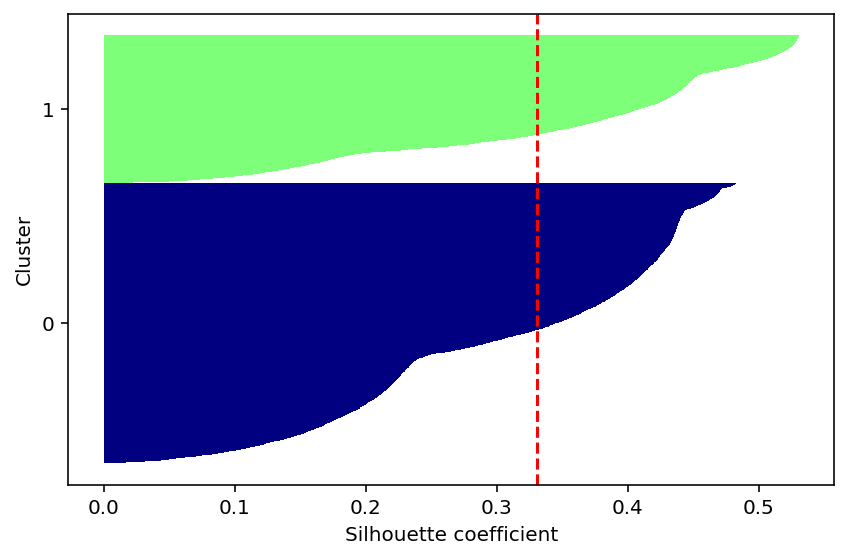

In [22]:
plot_silhouettes(pl_kmeans.transform(X),clusters)

The outcome of the silhoutte is confusing vs the completeness_score and homogeneity_score measures. It seems that the clustering is capturing another aspect of the customers that is more influential than being attrited or not.

In [23]:
# Check the clusters assignment distributions
clusters_df = pd.DataFrame(clusters, columns=["Cluster"])['Cluster']
clusters_df.value_counts()

0    5302
1    2799
Name: Cluster, dtype: int64

**Cluster assignments representation**

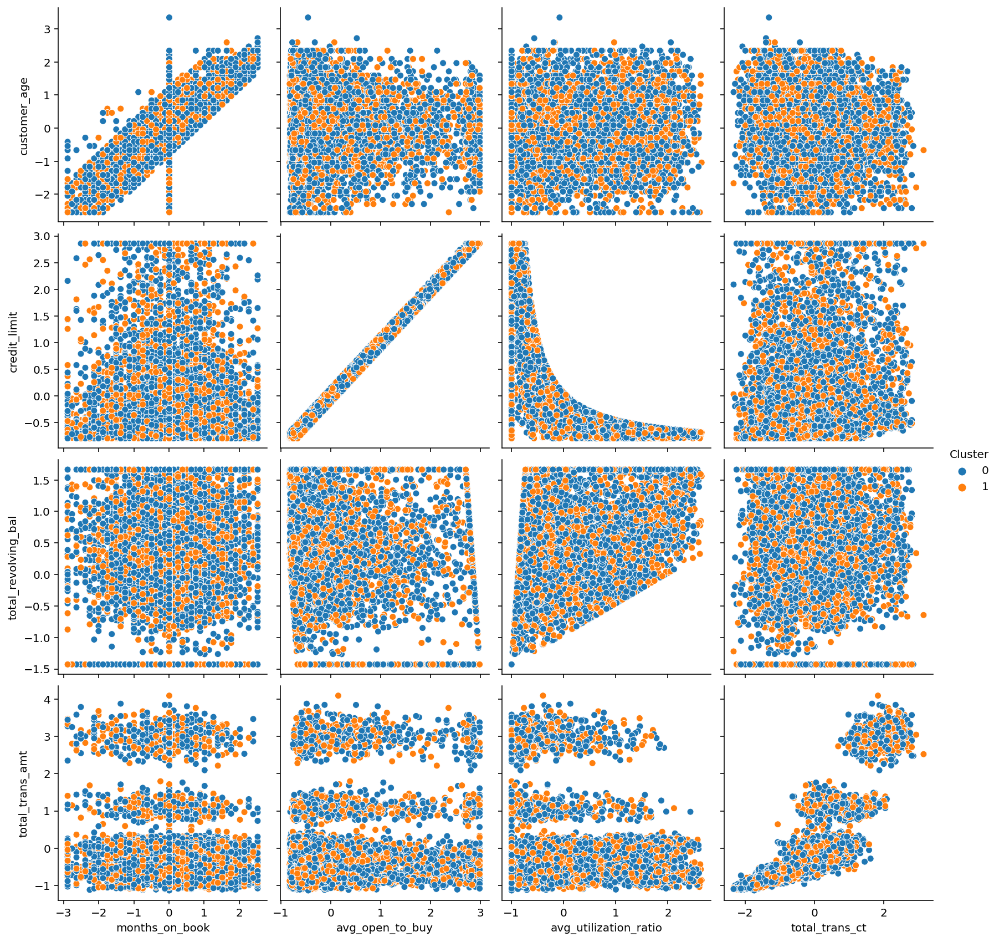

In [24]:
sns.pairplot(
    x_vars=['months_on_book','avg_open_to_buy','avg_utilization_ratio','total_trans_ct'],
    y_vars=['customer_age','credit_limit','total_revolving_bal','total_trans_amt'],
    hue='Cluster',
    height=3,
    data=X_enc.reset_index(drop=True).join(clusters_df)
    );

I can't indetify a coherent pattern in relation to attrited customers

After forcing 2 clusters as my target and getting really bad numbers, I will try to measure the best number of clusters fits

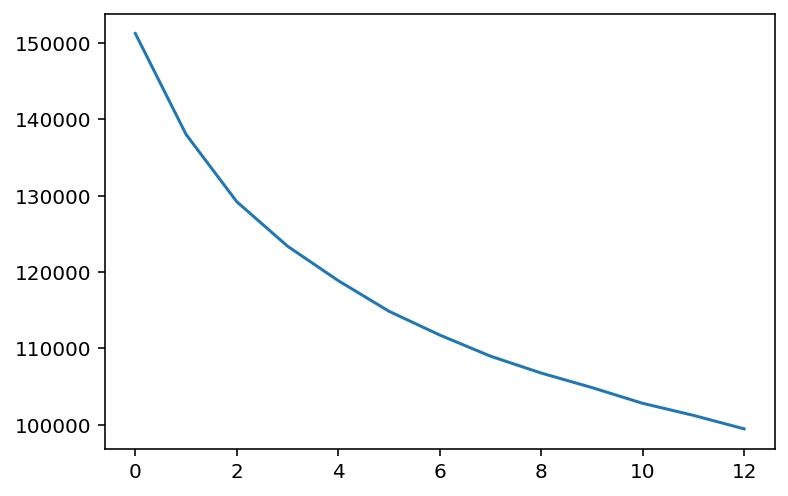

In [25]:
# Elbow-curve/SSD
ssd = []
range_n_clusters = range(2,15)
for num_clusters in range_n_clusters:
    pl_kmeans = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('cluster', KMeans(n_clusters=num_clusters))
    ])
    
    pl_kmeans.fit(X)
    kmeans = pl_kmeans.named_steps.cluster
    ssd.append(kmeans.inertia_)
    
# plot the SSDs for each n_clusters
plt.plot(ssd);

The elbow-curve seems very smooth without an obvious break.

In [26]:
# Silhouette Analysis
range_n_clusters = range(2,15)
for num_clusters in range_n_clusters:
    
    # Initialise kmeans
    pl_kmeans = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('cluster', KMeans(n_clusters=num_clusters))
    ])
    
    pl_kmeans.fit(X)
    kmeans = pl_kmeans.named_steps.cluster

    cluster_labels = kmeans.labels_
    
    # Silhouette Score
    silhouette_avg = silhouette_score(pl_kmeans.transform(X), cluster_labels)
    print("For n_clusters={0}, the silhouette score is {1}".format(num_clusters, silhouette_avg))
    

For n_clusters=2, the silhouette score is 0.33058696656689146
For n_clusters=3, the silhouette score is 0.28077661432643597
For n_clusters=4, the silhouette score is 0.22459580635782936
For n_clusters=5, the silhouette score is 0.2003431674542087
For n_clusters=6, the silhouette score is 0.19389476269768058
For n_clusters=7, the silhouette score is 0.14513003506103672
For n_clusters=8, the silhouette score is 0.13764532941378985
For n_clusters=9, the silhouette score is 0.11669726438973896
For n_clusters=10, the silhouette score is 0.10510913079179572
For n_clusters=11, the silhouette score is 0.10228526132664975
For n_clusters=12, the silhouette score is 0.10077782472802232
For n_clusters=13, the silhouette score is 0.08757846129891654
For n_clusters=14, the silhouette score is 0.08864981032044898


all bad scores

### Trying AgglomerativeClustering

In [27]:
pl_kmeans = Pipeline(
    steps=[
        ('preprocessor', preprocessor),
        ('cluster', AgglomerativeClustering(n_clusters=2))
    ])

clusters = pl_kmeans.fit_predict(X)
kmeans = pl_kmeans.named_steps.cluster

print('completeness_score: {:.2f}'.format(completeness_score(y,clusters)))
print('homogeneity_score:  {:.2f}'.format(homogeneity_score(y,clusters)))

completeness_score: 0.00
homogeneity_score:  0.00


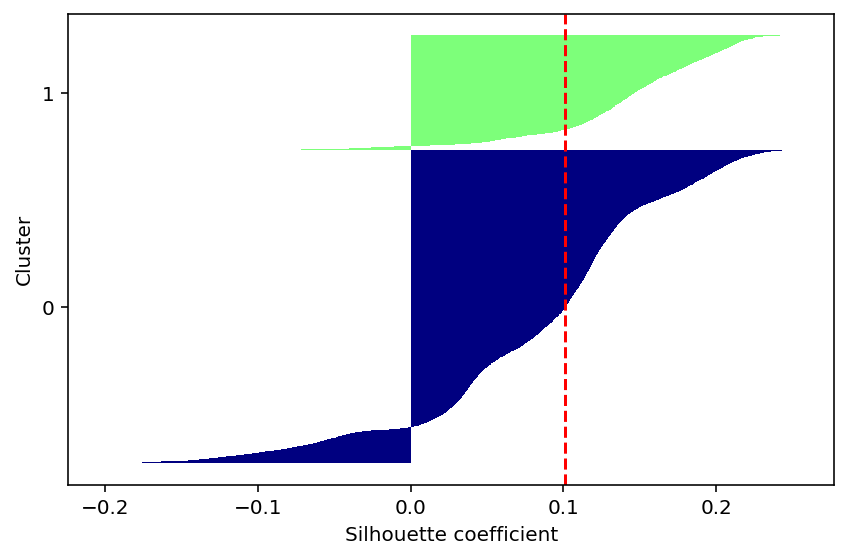

In [28]:
plot_silhouettes(X_enc,clusters)

In [29]:
# Check the clusters assignment distributions
clusters_df = pd.DataFrame(clusters, columns=["Cluster"])['Cluster']
clusters_df.value_counts()

0    5926
1    2175
Name: Cluster, dtype: int64

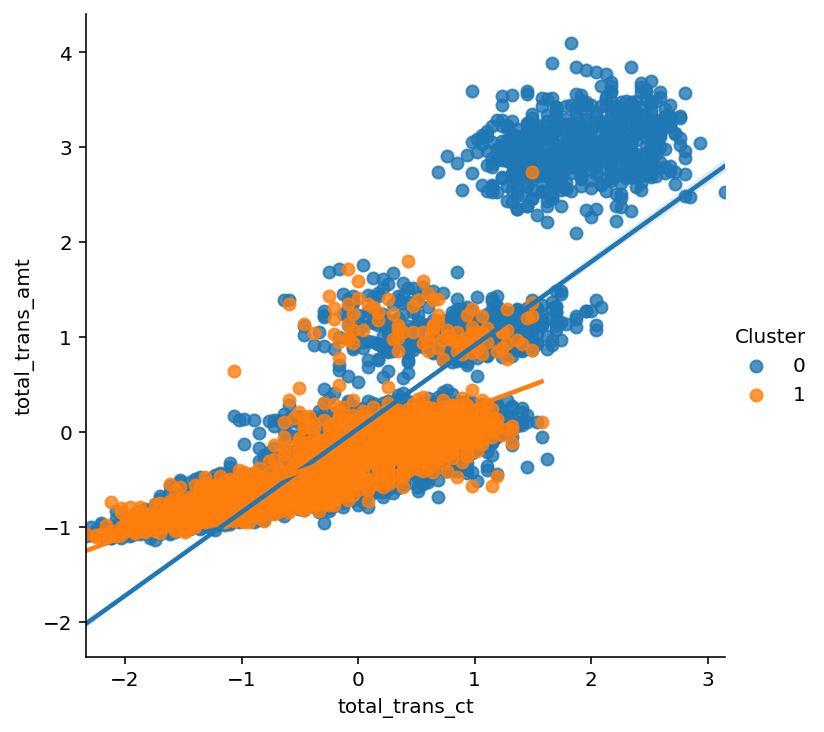

In [30]:
sns.lmplot(x="total_trans_ct", y="total_trans_amt", hue="Cluster",
           data=X_enc.reset_index(drop=True).join(clusters_df));

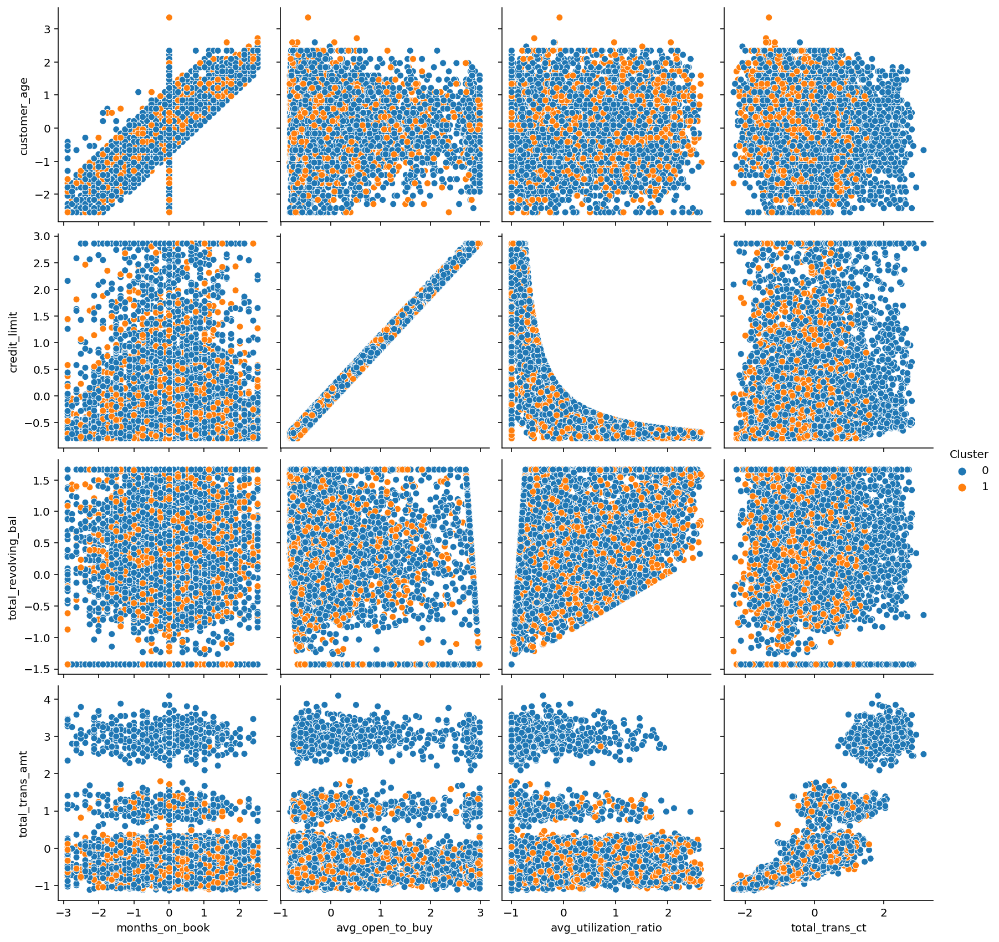

In [31]:
sns.pairplot(
    x_vars=['months_on_book','avg_open_to_buy','avg_utilization_ratio','total_trans_ct'],
    y_vars=['customer_age','credit_limit','total_revolving_bal','total_trans_amt'],
    hue='Cluster',
    height=3,
    data=X_enc.reset_index(drop=True).join(clusters_df)
    );

Still, I can't indetify a coherent pattern in relation to attrited customers

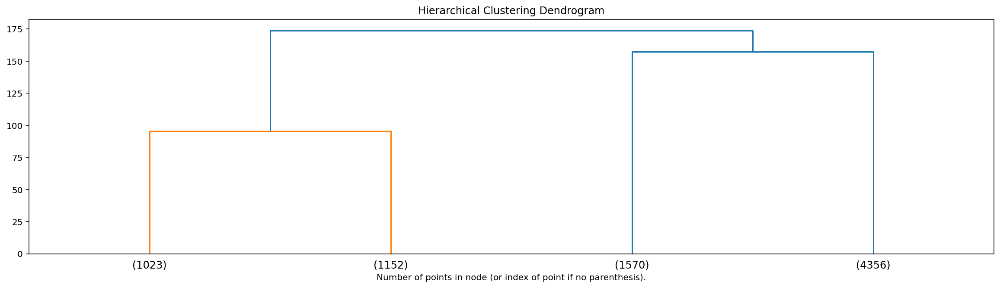

In [32]:
from sklearn.cluster import AgglomerativeClustering

# setting distance_threshold=0 ensures we compute the full tree.
model = AgglomerativeClustering(distance_threshold=0, n_clusters=None)
model = model.fit(X_enc)

plt.subplots(figsize=(20,5))
plt.title('Hierarchical Clustering Dendrogram')
# plot the top three levels of the dendrogram
plot_dendrogram(model, truncate_mode='level', p=1)
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

### Applying KernelPCA

I will try to apply different KernelPCA configutions to explore the cluster patterns of attrited customers in higher dimensions

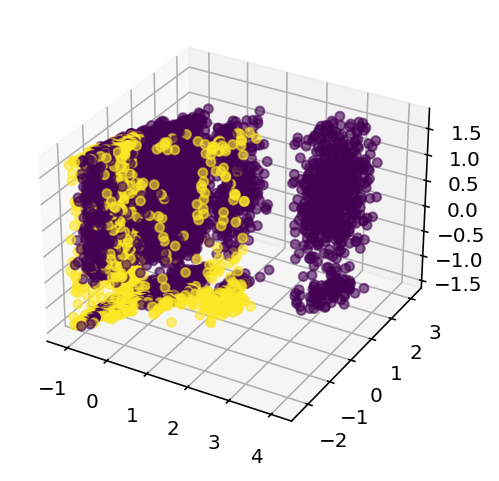

In [33]:
_ = X_enc[['total_trans_amt','total_trans_ct','total_revolving_bal']]
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
#ax.scatter(xs, ys, zs, marker=m)
ax.scatter(_.iloc[:,0],_.iloc[:,1],_.iloc[:,2],c=y, alpha=.6);

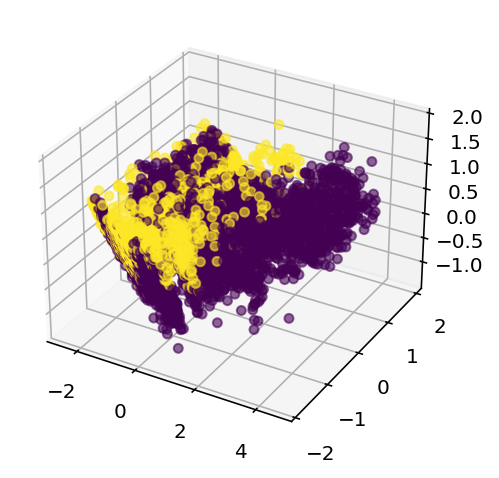

In [34]:
_ = X_enc[['total_trans_amt','total_trans_ct','total_revolving_bal']]
_ = PCA(3).fit_transform(_)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
#ax.scatter(xs, ys, zs, marker=m)
ax.scatter(_[:,0],_[:,1],_[:,2],c=y, alpha=.6);

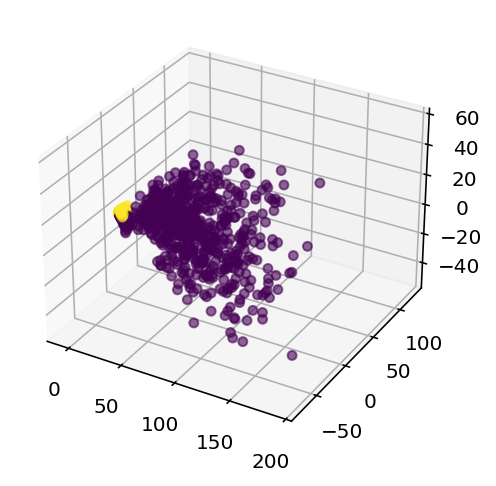

In [35]:
_ = X_enc[['total_trans_amt','total_trans_ct','total_revolving_bal']]
_ = KernelPCA(3, kernel='poly', degree=5).fit_transform(_)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(_[:,0],_[:,1],_[:,2],c=y, alpha=.6);

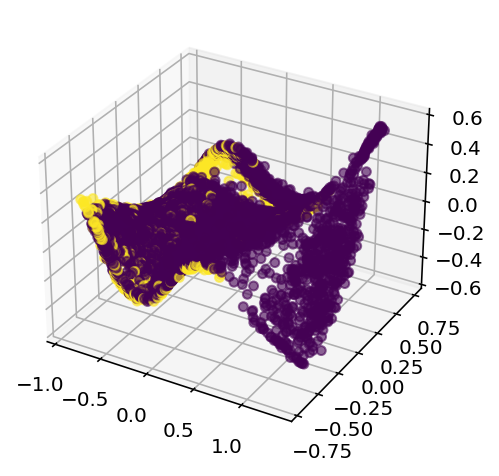

In [36]:
_ = X_enc[['total_trans_amt','total_trans_ct','total_revolving_bal']]
_ = KernelPCA(3, kernel='sigmoid').fit_transform(_)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(_[:,0],_[:,1],_[:,2],c=y, alpha=.6);

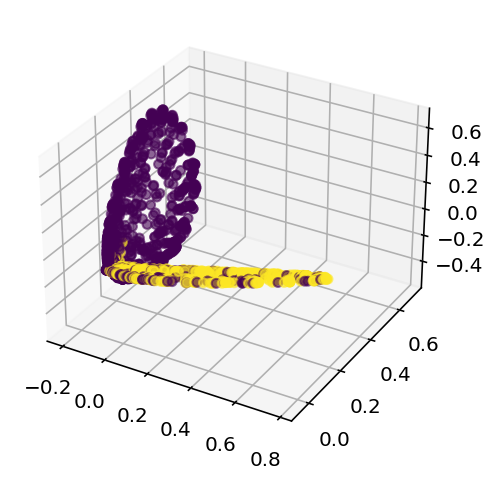

In [37]:
_ = X_enc[['total_trans_amt','total_trans_ct','total_revolving_bal']]
_ = KernelPCA(3, kernel='rbf', gamma=50, alpha=10).fit_transform(_)
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(_[:,0],_[:,1],_[:,2],c=y, alpha=.6);

completeness_score: 0.28
homogeneity_score:  0.19


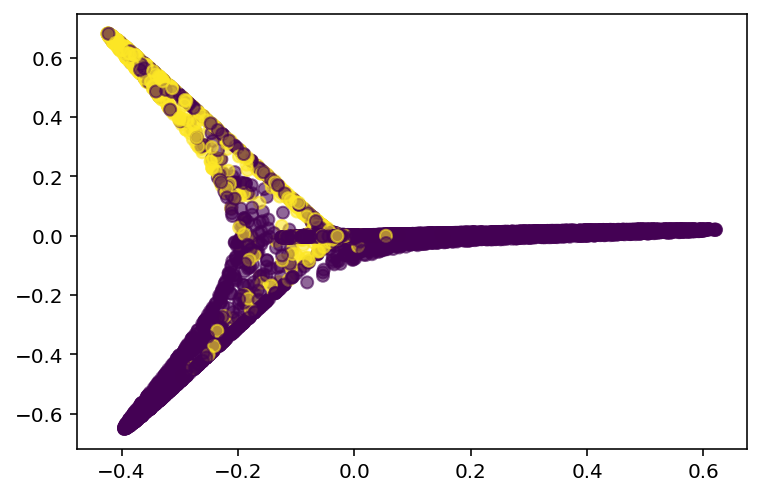

In [38]:
_ = X_enc[['total_trans_amt','total_trans_ct','total_revolving_bal']]
_ = KernelPCA(3, kernel='rbf', gamma=5).fit_transform(_)
clst = KMeans(2).fit_predict(_)
print('completeness_score: {:.2f}'.format(completeness_score(y,clst)))
print('homogeneity_score:  {:.2f}'.format(homogeneity_score(y,clst)))
#fig = plt.figure()
#ax = fig.add_subplot(111, projection='3d')
plt.scatter(_[:,0],_[:,1],c=y, alpha=.6);

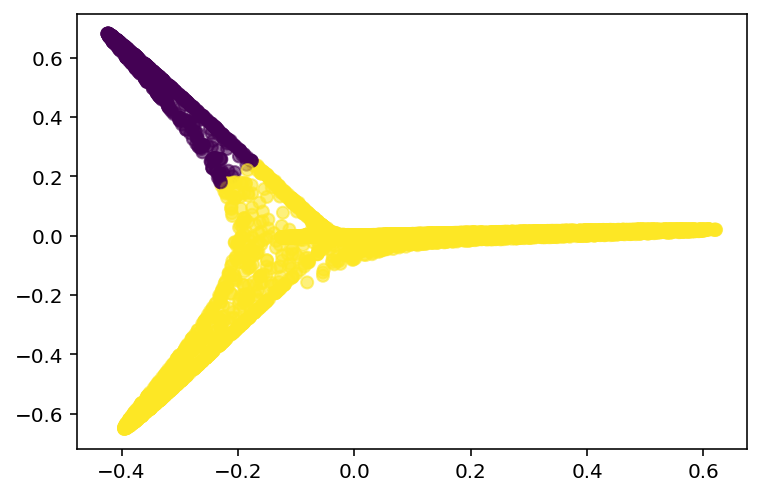

In [39]:
plt.scatter(_[:,0],_[:,1],c=clst, alpha=.6);

Trying to tune the Kernel Parameters to find the best completeness and homogeneity scores

In [40]:
for i in np.arange(1,10,1):
    _ = X_enc[['total_trans_amt','total_trans_ct','total_revolving_bal']]
    _ = KernelPCA(3, kernel='rbf', gamma=i).fit_transform(_)
    clst = KMeans(2).fit_predict(_)
    print(i)
    print('completeness_score: {:.2f}'.format(completeness_score(y,clst)))
    print('homogeneity_score:  {:.2f}'.format(homogeneity_score(y,clst)))
    print()
    #fig = plt.figure()
    #ax = fig.add_subplot(111, projection='3d')
    #ax.scatter(_[:,0],_[:,1],_[:,2],c=clst, alpha=.6);
    
    
    
    
#5
#completeness_score: 0.28
#homogeneity_score:  0.19

1
completeness_score: 0.11
homogeneity_score:  0.16

2
completeness_score: 0.10
homogeneity_score:  0.14

3
completeness_score: 0.09
homogeneity_score:  0.13

4
completeness_score: 0.09
homogeneity_score:  0.12

5
completeness_score: 0.28
homogeneity_score:  0.19

6
completeness_score: 0.29
homogeneity_score:  0.18

7
completeness_score: 0.29
homogeneity_score:  0.17

8
completeness_score: 0.28
homogeneity_score:  0.17

9
completeness_score: 0.29
homogeneity_score:  0.17



completeness_score: 0.05
homogeneity_score:  0.03


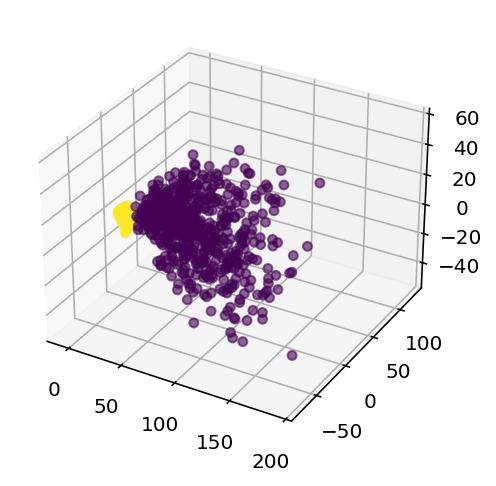

In [41]:
_ = X_enc[['total_trans_amt','total_trans_ct','total_revolving_bal']]
_ = KernelPCA(3, kernel='poly', degree=5).fit_transform(_)
clst = AgglomerativeClustering().fit_predict(_)
print('completeness_score: {:.2f}'.format(completeness_score(y,clst)))
print('homogeneity_score:  {:.2f}'.format(homogeneity_score(y,clst)))
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.scatter(_[:,0],_[:,1],_[:,2],c=clst, alpha=.6);

completeness_score: 0.05
homogeneity_score:  0.03


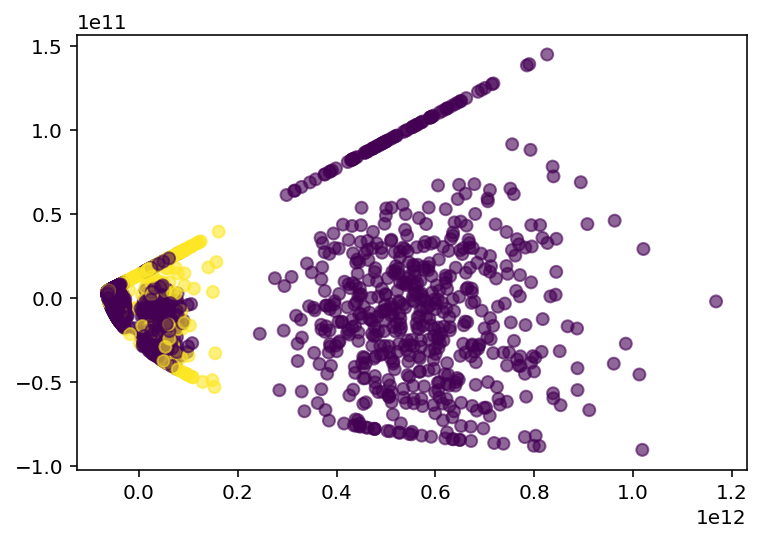

In [42]:
_ = df_train[['total_trans_amt','total_trans_ct','total_revolving_bal']]
_ = KernelPCA(2, kernel='poly').fit_transform(_)
clst = AgglomerativeClustering(2).fit_predict(_)
print('completeness_score: {:.2f}'.format(completeness_score(y,clst)))
print('homogeneity_score:  {:.2f}'.format(homogeneity_score(y,clst)))
plt.scatter(_[:,0],_[:,1],c=y, alpha=.6);

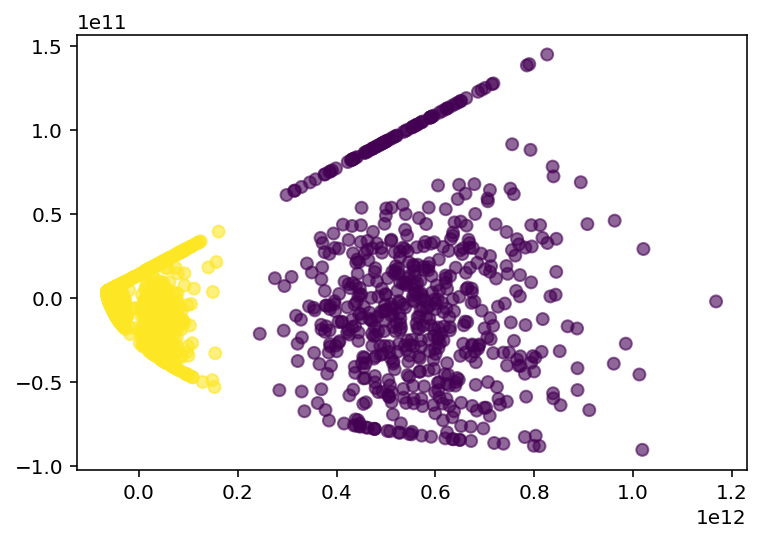

In [43]:
plt.scatter(_[:,0],_[:,1],c=clst, alpha=.6);

completeness_score: 1.00
homogeneity_score:  0.00


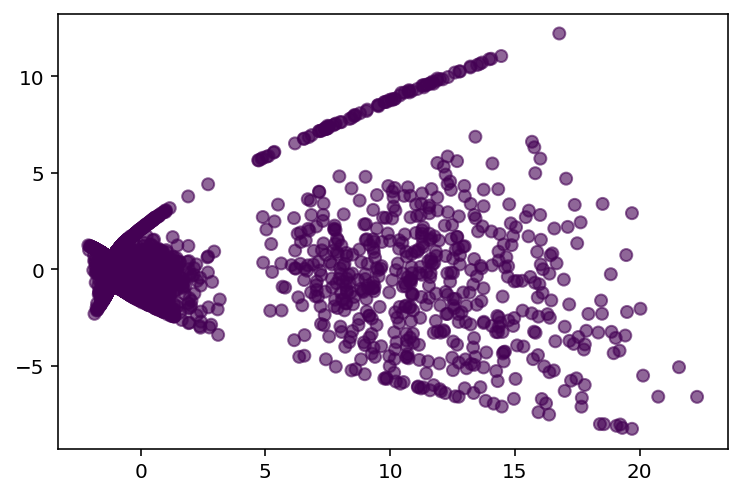

In [44]:
_ = X_enc[['total_trans_amt','total_trans_ct','total_revolving_bal']]
_ = KernelPCA(2, kernel='poly').fit_transform(_)
clst = DBSCAN(metric='cosine').fit_predict(_)
print('completeness_score: {:.2f}'.format(completeness_score(y,clst)))
print('homogeneity_score:  {:.2f}'.format(homogeneity_score(y,clst)))
plt.scatter(_[:,0],_[:,1],c=clst, alpha=.6);

completeness_score: 0.05
homogeneity_score:  0.03


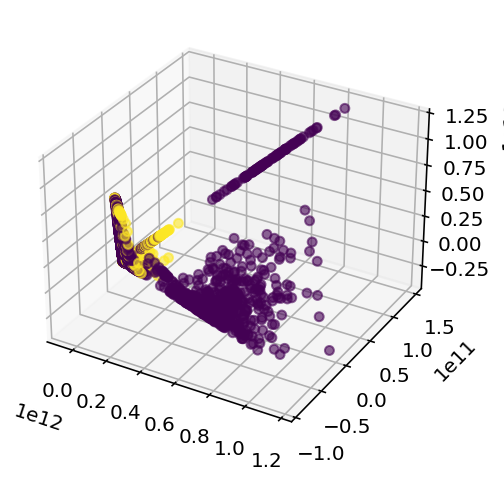

In [45]:
_ = df_train[['total_trans_amt','total_trans_ct','total_revolving_bal']]
_ = KernelPCA(3, kernel='poly').fit_transform(_)
clst = AgglomerativeClustering(2).fit_predict(_)
print('completeness_score: {:.2f}'.format(completeness_score(y,clst)))
print('homogeneity_score:  {:.2f}'.format(homogeneity_score(y,clst)))
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
#ax.scatter(xs, ys, zs, marker=m)
ax.scatter(_[:,0],_[:,1],_[:,2],c=y, alpha=.6);

It's clear that attrited customers are not the most influential profile characteristic, seems that there are other profiling charactersics.
Since my variable of interest is attrited customers, I'm concluding that clustering is not appropriate for analysing the attrited customers.

In my next steps, I will try classification modeling to predict attrited customers.

# End